Data Analysis of used cars on eBay

In [1]:
import pandas as pd
import plotly.express as px
import seaborn as sns
import matplotlib.pyplot as plt

In [2]:
df=pd.read_csv("archive (2).zip",encoding="latin1")

In [3]:
df

,dateCrawled,name,seller,offerType,price,abtest,vehicleType,yearOfRegistration,gearbox,powerPS,model,kilometer,monthOfRegistration,fuelType,brand,notRepairedDamage,dateCreated,nrOfPictures,postalCode,lastSeen
0,2016-03-24 11:52:17,Golf_3_1.6,privat,Angebot,480,test,NaN,1993,manuell,0,golf,150000,0,benzin,volkswagen,NaN,2016-03-24 00:00:00,0,70435,2016-04-07 03:16:57
1,2016-03-24 10:58:45,A5_Sportback_2.7_Tdi,privat,Angebot,18300,test,coupe,2011,manuell,190,NaN,125000,5,diesel,audi,ja,2016-03-24 00:00:00,0,66954,2016-04-07 01:46:50
2,2016-03-14 12:52:21,"Jeep_Grand_Cherokee_""Overland""",privat,Angebot,9800,test,suv,2004,automatik,163,grand,125000,8,diesel,jeep,NaN,2016-03-14 00:00:00,0,90480,2016-04-05 12:47:46
3,2016-03-17 16:54:04,GOLF_4_1_4__3TÜRER,privat,Angebot,1500,test,kleinwagen,2001,manuell,75,golf,150000,6,benzin,volkswagen,nein,2016-03-17 00:00:00,0,91074,2016-03-17 17:40:17
4,2016-03-31 17:25:20,Skoda_Fabia_1.4_TDI_PD_Classic,privat,Angebot,3600,test,kleinwagen,2008,manuell,69,fabia,90000,7,diesel,skoda,nein,2016-03-31 00:00:00,0,60437,2016-04-06 10:17:21
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
371523,2016-03-14 17:48:27,Suche_t4___vito_ab_6_sitze,privat,Angebot,2200,test,NaN,2005,NaN,0,NaN,20000,1,NaN,sonstige_autos,NaN,2016-03-14 00:00:00,0,39576,2016-04-06 00:46:52
371524,2016-03-05 19:56:21,Smart_smart_leistungssteigerung_100ps,privat,Angebot,1199,test,cabrio,2000,automatik,101,fortwo,125000,3,benzin,smart,nein,2016-03-05 00:00:00,0,26135,2016-03-11 18:17:12
371525,2016-03-19 18:57:12,Volkswagen_Multivan_T4_TDI_7DC_UY2,privat,Angebot,9200,test,bus,1996,manuell,102,transporter,150000,3,diesel,volkswagen,nein,2016-03-19 00:00:00,0,87439,2016-04-07 07:15:26
371526,2016-03-20 19:41:08,VW_Golf_Kombi_1_9l_TDI,privat,Angebot,3400,test,kombi,2002,manuell,100,golf,150000,6,diesel,volkswagen,NaN,2016-03-20 00:00:00,0,40764,2016-03-24 12:45:21


In [4]:
df.isnull().sum()

dateCrawled                0
name                       0
seller                     0
offerType                  0
price                      0
abtest                     0
vehicleType            37869
yearOfRegistration         0
gearbox                20209
powerPS                    0
model                  20484
kilometer                  0
monthOfRegistration        0
fuelType               33386
brand                      0
notRepairedDamage      72060
dateCreated                0
nrOfPictures               0
postalCode                 0
lastSeen                   0
dtype: int64

In [5]:
df.dropna(inplace=True)

yearwise number of total cars sold 

In [6]:
y=df.groupby('yearOfRegistration')['brand'].count()
df['Total'] = df['yearOfRegistration'].map(y)

In [7]:
px.scatter(df,x='brand',y='Total',color='yearOfRegistration')

total vehicles sold by their vehicle types

In [8]:
y=df.groupby('vehicleType')['brand'].count()
df_1=pd.DataFrame(y)

In [9]:
df_1

,brand
vehicleType,
andere,1772
bus,24963
cabrio,18549
coupe,14651
kleinwagen,59103
kombi,53442
limousine,76394
suv,12082


In [10]:
v_t=['andere' ,'bus', 'cabrio', 'coupe', 'kleinwagen' ,'kombi','limousine', 'suv']
df_1['VT']=v_t

In [11]:
px.bar(df_1,x='VT',y='brand',color='VT')

distribution of vehicles by the year of registration

Text(0.5, 0, 'YOR')

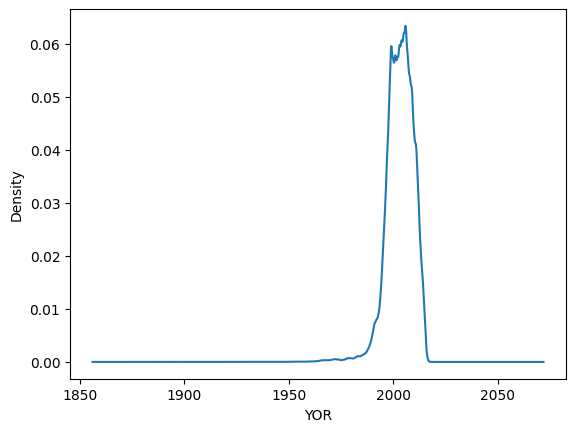

In [12]:
df['yearOfRegistration'].plot(kind='kde')
plt.xlabel('YOR')

average vehicle price based on the type of vehicle and the type of gearbox

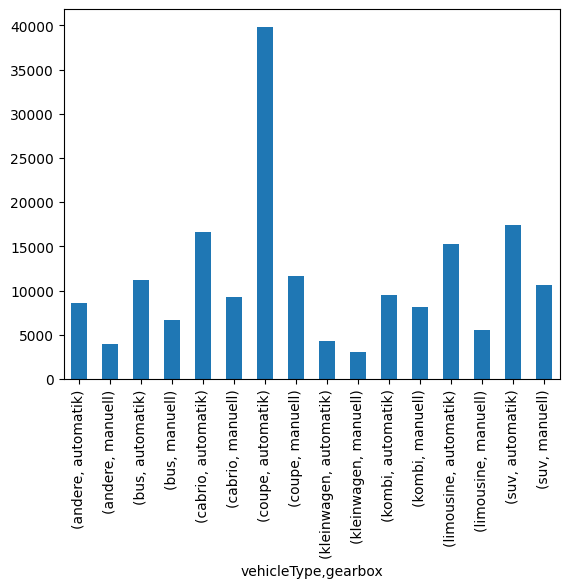

In [13]:
y=df.groupby(['vehicleType','gearbox'])['price'].mean().plot(kind='bar',)

In [14]:
y=df.groupby(['vehicleType','gearbox'])['price'].mean()

In [15]:
df_2=pd.DataFrame(y)

In [16]:
df_2

price
vehicleType gearbox                
andere      automatik   8579.578947
            manuell     3952.924422
bus         automatik  11198.040428
            manuell     6687.986398
cabrio      automatik  16577.354983
            manuell     9253.037953
coupe       automatik  39846.241546
            manuell    11640.327791
kleinwagen  automatik   4267.352880
            manuell     3008.467656
kombi       automatik   9489.952917
            manuell     8096.881695
limousine   automatik  15214.969330
            manuell     5537.229802
suv         automatik  17405.184790
            manuell    10609.850477

In [17]:
k=['automatik','manuell','automatik','manuell','automatik','manuell','automatik','manuell','automatik','manuell','automatik','manuell','automatik','manuell','automatik','manuell']
df_2['gear']=k

In [18]:
l=['andere','andere','bus','bus','cabrio','cabrio','coupe','coupe','kleinwagen','kleinwagen','kombi','kombi','limousine','limousine','suv','suv']
df_2['vehicle type']=l

In [19]:
px.bar(df_2,x='vehicle type',y='price',color='gear')

 average vehicle price based on the type of fuel and the type of gearbox

In [20]:
z=df.groupby(['fuelType','gearbox'])['price'].mean()

In [21]:
z

fuelType  gearbox  
andere    automatik     3791.764706
          manuell       2885.500000
benzin    automatik    10293.675540
          manuell       5729.126860
cng       automatik     7566.400000
          manuell       4809.783721
diesel    automatik    20351.588317
          manuell       7288.463502
elektro   automatik    11730.255319
          manuell       4309.900000
hybrid    automatik    15269.635870
          manuell       6733.103448
lpg       automatik     5840.196078
          manuell       3492.062653
Name: price, dtype: float64

In [23]:
df_3=pd.DataFrame(z)
k_1=['automatik','manuell','automatik','manuell','automatik','manuell','automatik','manuell','automatik','manuell','automatik','manuell','automatik','manuell']
df_3['gear']=k_1
f=['andere','andere','benzin','benzin','cng','cng','diesel','diesel','elektro','elektro','hybrid','hybrid','lpg','lpg']
df_3['fuel type']=f

In [24]:
df_3

price       gear fuel type
fuelType gearbox                                     
andere   automatik   3791.764706  automatik    andere
         manuell     2885.500000    manuell    andere
benzin   automatik  10293.675540  automatik    benzin
         manuell     5729.126860    manuell    benzin
cng      automatik   7566.400000  automatik       cng
         manuell     4809.783721    manuell       cng
diesel   automatik  20351.588317  automatik    diesel
         manuell     7288.463502    manuell    diesel
elektro  automatik  11730.255319  automatik   elektro
         manuell     4309.900000    manuell   elektro
hybrid   automatik  15269.635870  automatik    hybrid
         manuell     6733.103448    manuell    hybrid
lpg      automatik   5840.196078  automatik       lpg
         manuell     3492.062653    manuell       lpg

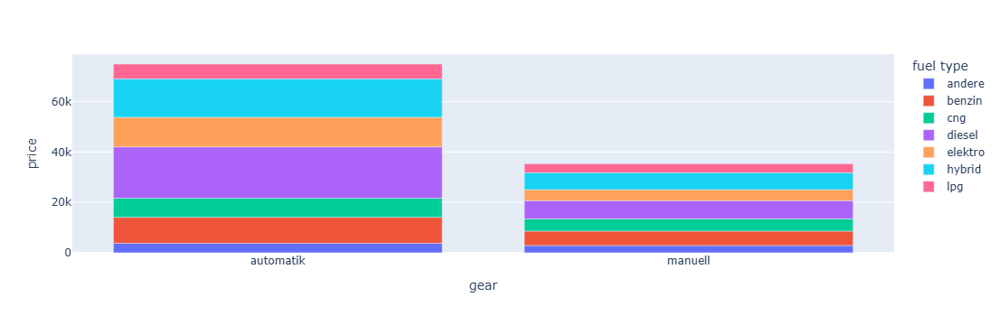

In [25]:
px.bar(df_3,x='gear',y='price',color='fuel type')

average power of a vehicle by type of vehicle and type of gearbox

In [26]:
df.groupby(['vehicleType','gearbox'])['powerPS'].mean()

vehicleType  gearbox  
andere       automatik    148.327485
             manuell       96.230481
bus          automatik    143.683318
             manuell      112.042645
cabrio       automatik    188.867465
             manuell      138.060417
coupe        automatik    224.500604
             manuell      161.311680
kleinwagen   automatik     79.608920
             manuell       71.599115
kombi        automatik    178.471564
             manuell      127.365247
limousine    automatik    183.827883
             manuell      119.462241
suv          automatik    211.683789
             manuell      130.717713
Name: powerPS, dtype: float64

<Axes: xlabel='vehicleType,gearbox'>

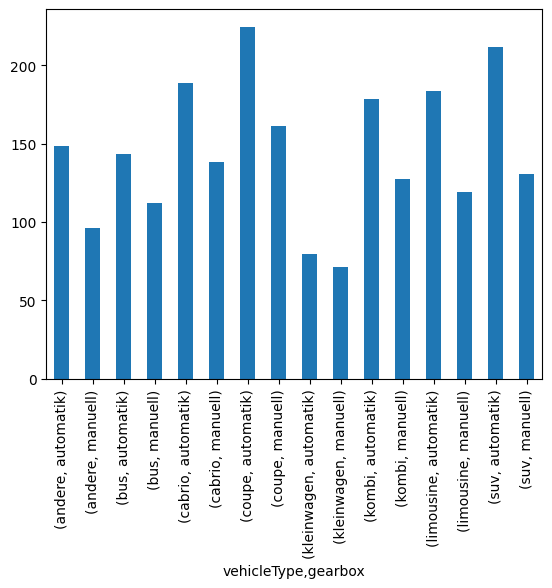

In [27]:
df.groupby(['vehicleType','gearbox'])['powerPS'].mean().plot(kind='bar')

average price of a vehicle by brand and type of vehicle

<Axes: xlabel='vehicleType,brand'>

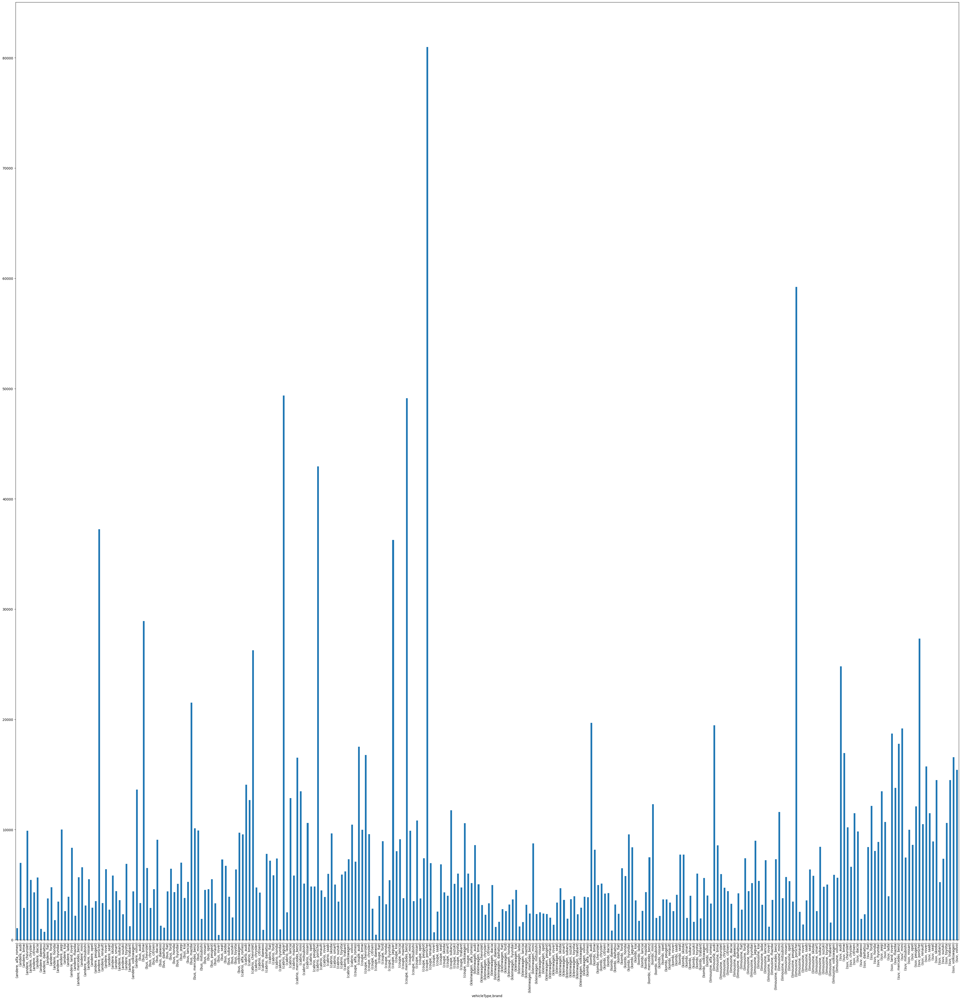

In [45]:
df.groupby(['vehicleType','brand'])['price'].mean().plot(kind='bar',figsize=(50,50))